# Hierarchically coupled causal models

This notebook explores how to generate hierarchically coupled causal models. 

In [ ]:
# Autoreload extension
%load_ext autoreload
%autoreload 2

%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [13]:
import numpy as np
import torch
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl

from causaldynamics.utils import set_rng_seed
from causaldynamics.initialization import initialize_weights, initialize_biases, initialize_x
from causaldynamics.scm import create_scm_graph, get_root_nodes_mask, GrowingNetworkWithRedirection
from causaldynamics.mlp import propagate_mlp
from causaldynamics.systems import calculate_linear_data, solve_system, solve_random_systems
from causaldynamics.plot import plot_trajectories, animate_3d_trajectories, plot_scm

In [14]:
# Set a fixed seed for reproducibility
set_rng_seed(42)

# Increase the animation limit to 50MB
mpl.rcParams['animation.embed_limit'] = 50 * 1024**2 

## Simple instructive example

Let's create a minimal example with a causal graph that has two nodes 0 and 1 and a single edge 1<-0. The signal we send through that graph is given by a Lorenz attractor with dimension 3 that is calculated for 50 time steps.

In [15]:
# Define parameters for a small test example
N_nodes = 2
N_timesteps = 1000
N_dimensions = 3

# Generate Lorenz attractor trajectory
d_lorenz = solve_system(N_timesteps, N_nodes, "Lorenz")

In [16]:
# Sample the simplest possible adjacency matrix: 0<--1
A = GrowingNetworkWithRedirection(N_nodes).generate()
A

tensor([[0., 0.],
        [1., 0.]])

In [17]:
# Sample random weights for the MLPs
W = initialize_weights(N_nodes, N_dimensions)
W


tensor([[[ 1.8306,  0.1129,  0.4252],
         [-1.3446,  1.6114,  0.5914],
         [-1.1415, -0.5930, -0.0058]],

        [[ 1.4170, -2.0788,  0.6370],
         [ 1.3824, -0.9156,  0.0159],
         [ 0.7230, -0.3092,  0.8614]]])

In [18]:
# Sample random biases for the MLPs
b = initialize_biases(N_nodes, N_dimensions)
b


tensor([[ 1.2865, -1.7983,  0.3016],
        [ 2.6508, -1.3340,  0.6698]])

Let's plot the minimal test graph 1<--0 and propagate the Lorenz attractor through the causal graph. 

First, nitialize the root node 1 with the time-series data from the Lorenz attractor. Then, propagate this signal through the edge 1->0. The signal is the input to the sampled multilayer perceptron (MLP) with no activation function. The output is the state of node 0.

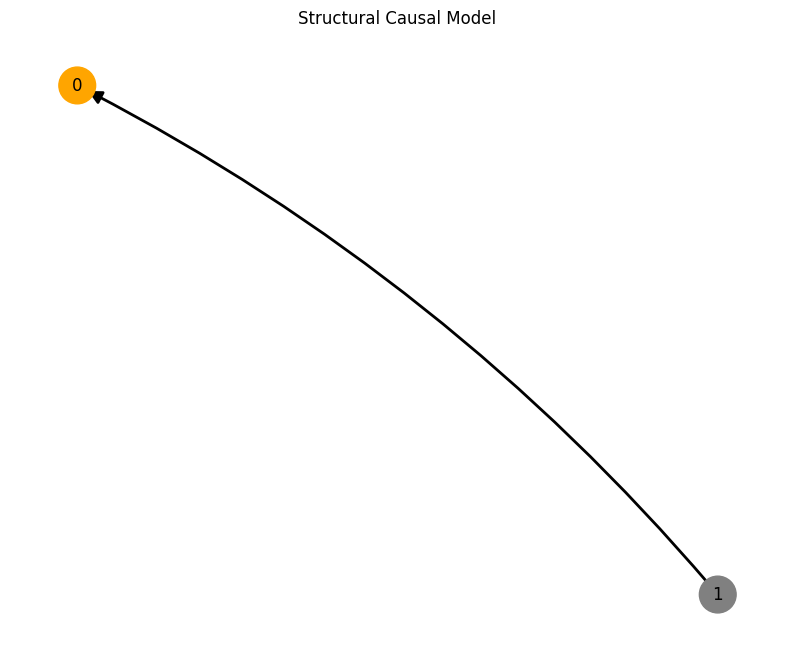

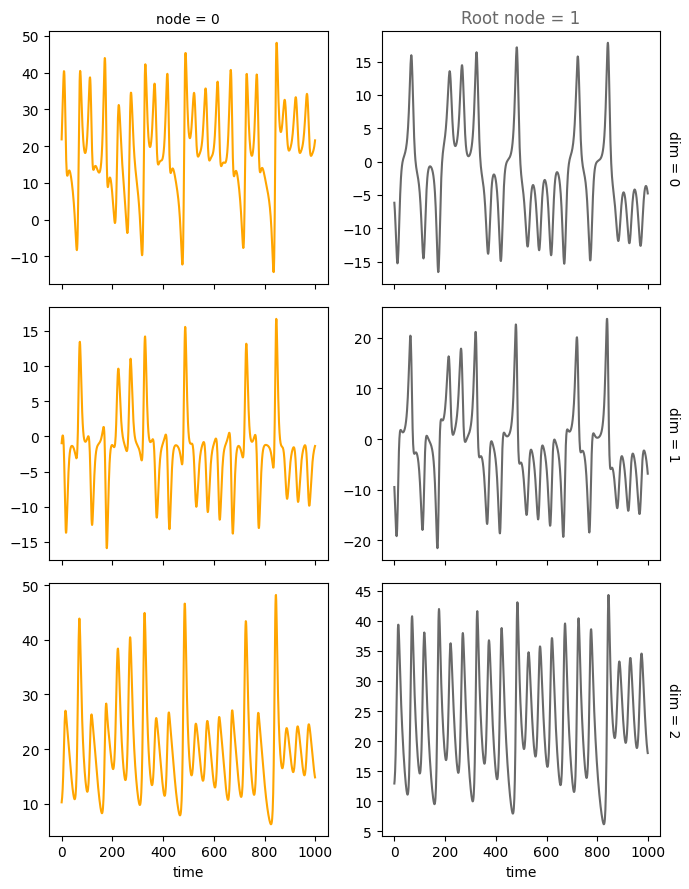

In [19]:
# Initialize the root nodes with the Lorenz attractor
init = initialize_x(d_lorenz, A)

# Propagate Lorenz trajectory through the SCM
x = propagate_mlp(A, W, b, init=init)

# Visualize the results using xarray
da = xr.DataArray(x, dims=['time', 'node', "dim"])
root_nodes = get_root_nodes_mask(A)

plot_scm(G=create_scm_graph(A), root_nodes=root_nodes)
plt.show()

plot_trajectories(da, root_nodes=root_nodes, sharey=False)
plt.show()

In [21]:
# Create an animation of the simple coupled Lorenz attractor. 
da_sel = da.isel(time=slice(0, 500))
anim = animate_3d_trajectories(da_sel, frame_skip=2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


### iSCM v.s. SCM
Let's look at the difference between internally-standardized SCMs (iSCMS) and not standardized SCMs.

In [ ]:
# Set parameters
num_nodes = 2
num_timesteps = 1000
dimensions = 3

# Sample the SCM, all hyperparameters and propagate the Lorenz attractor through the SCM
A = GrowingNetworkWithRedirection(num_nodes).generate()
root_nodes = get_root_nodes_mask(A)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
d_lorenz = solve_system(num_timesteps, num_nodes, "Lorenz")
init = initialize_x(d_lorenz, A)

x = propagate_mlp(A, W, b, init=init)
da = xr.DataArray(x, dims=['time', 'node', "dim"])

x_s = propagate_mlp(A, W, b, init=init, standardize=True)
da_s = xr.DataArray(x_s, dims=['time', 'node', "dim"])

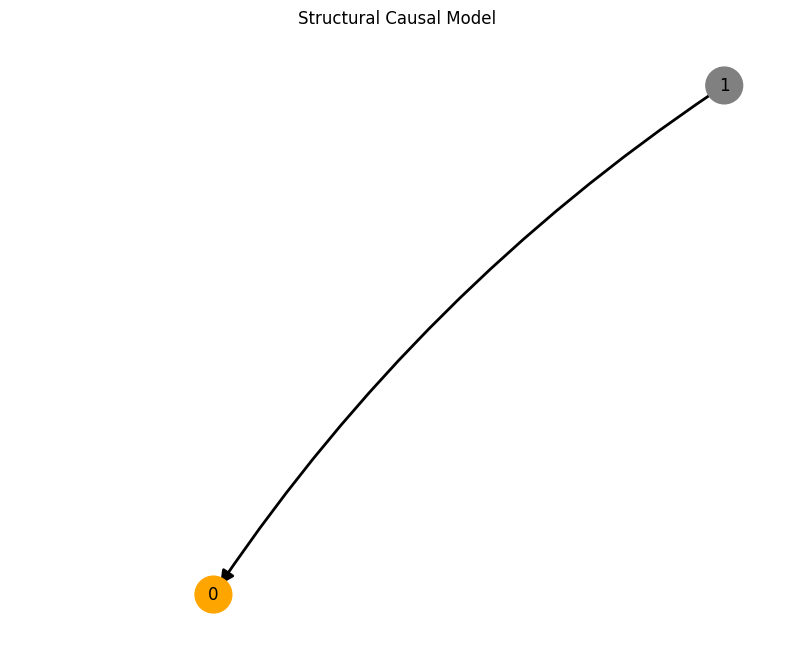

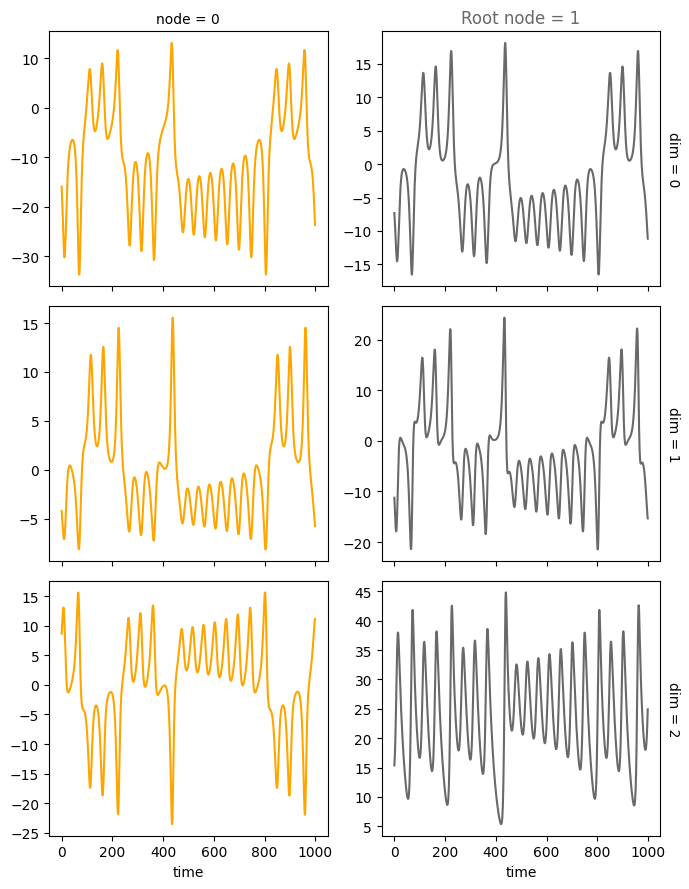

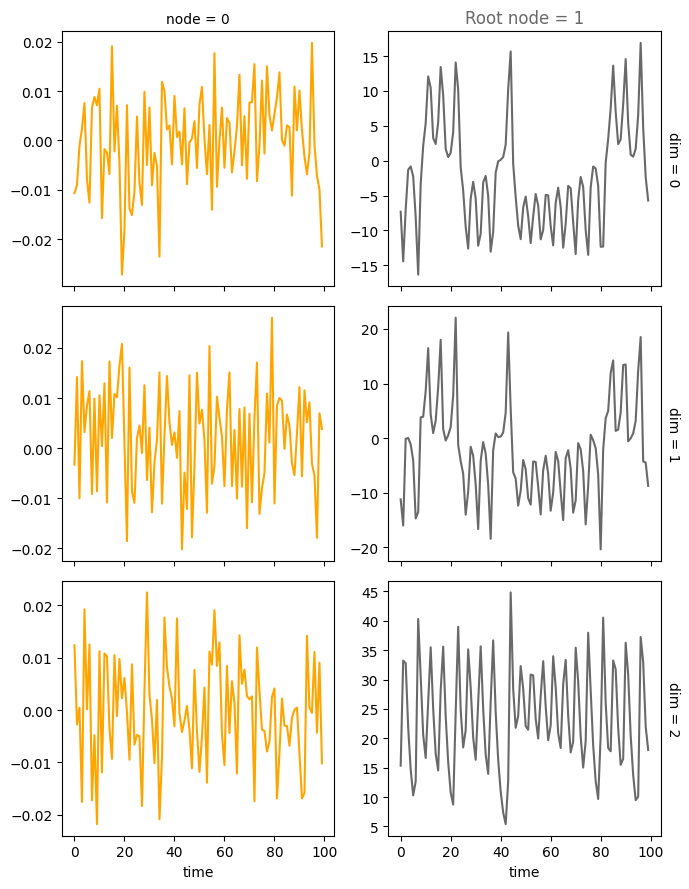

In [ ]:
# Plot the SCM graph
plot_scm(G=create_scm_graph(A), root_nodes=root_nodes)
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes, sharey=False)
da_s_sel = da_s.isel(time=slice(None, None, 10))
plot_trajectories(da_s_sel, root_nodes, sharey=False)
plt.show()

# # Animate the trajectories. This takes a while to run...
# anim = animate_3d_trajectories(da, frame_skip=5, rotation_speed=0.2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
# display(anim)


And now for 20 nodes

In [ ]:
# This takes a while to run...
# Set parameters
set_rng_seed(1337)
num_nodes = 10
num_timesteps = 2000
dimensions = 3

# Sample the SCM, all hyperoparameters and propagate the Lorenz attractor through the SCM
A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


### Let's add more chaotic systems

Now, let's add another chaotic system and initialize the system with Lorenz and Rossler attractors.

Let's start by focusing on a small system first again. The SCM graph is: 1->0<-2

In [34]:
# Set parameters
num_nodes = 3
num_timesteps = 200
dimensions = 3

# Sample the SCM, all hyperoparameters and propagate the Lorenz attractor through the SCM
A = torch.tensor([[0., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.]])
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
init2 = solve_system(num_timesteps, num_nodes, "Rossler")
init[:, 1] = init2[:, 1]
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
mpl.rcParams['animation.embed_limit'] = 50 * 1024**2  # 50MB

# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


Now, we look at a linear chain: 2->1->0

In [36]:
# Sample the SCM, all hyperoparameters and propagate the Lorenz attractor through the SCM
A = torch.tensor([[0., 0., 0.],
        [1., 0., 0.],
        [0., 1., 0.]])
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
init2 = solve_system(num_timesteps, num_nodes, "Rossler")
init[:, 1] = init2[:, 1]
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
mpl.rcParams['animation.embed_limit'] = 50 * 1024**2  # 50MB

# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


Let's scale it up to 10 nodes :) 

In [ ]:
# This takes a while to run...
# Set parameters
num_nodes = 10
num_timesteps = 2000
dimensions = 3

# Sample the SCM, all hyperoparameters and propagate the Lorenz attractor through the SCM
A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
init2 = solve_system(num_timesteps, num_nodes, "Rossler")
[init[:, i*2] = init2[:, i*2] for i in range(num_nodes//2)]

x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
mpl.rcParams['animation.embed_limit'] = 50 * 1024**2  # 50MB

# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=5, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


## Nonlinearities
Let's investigate non-linear activations at the MLP edges. 

It is possible to assign different MLP activation functions on different edges.

Let's first look at a minimal example, the graph 0<-1, and f(x)=x**3 as activation function.

In [36]:
# Set parameters
num_nodes = 2
num_timesteps = 200
dimensions = 3

# Sample the SCM, all hyperparameters and propagate the attractors through the SCM
act_funcs = np.array([lambda x: x**3, lambda x: torch.tanh(x), lambda x: torch.exp(x)])
act_idx = torch.tensor([0, 1]) # torch.ones(D, dtype=torch.int) * 0
activations = (act_idx, act_funcs)

A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
init2 = solve_system(num_timesteps, num_nodes, "Rossler")
[init[:, i*2] = init2[:, i*2] for i in range(num_nodes//2)]
x = propagate_mlp(A, W, b, init=init, activations=activations)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=1, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


Scale it up a bit...

In [ ]:
# Set parameters
num_nodes = 10
num_timesteps = 1000
dimensions = 3

# Sample the SCM, all hyperparameters and propagate the attractors through the SCM
act_funcs = np.array([lambda x: x**2, 
                      lambda x: x**2, 
                      lambda x: torch.tanh(x), 
                      lambda x: torch.sin(x), 
                      lambda x: torch.cos(x), 
                      lambda x: torch.abs(x), 
                      lambda x: torch.sign(x), 
                      lambda x: torch.relu(x), 
                      lambda x: torch.tanh(x), 
                      lambda x: torch.sigmoid(x)])
act_idx = torch.tensor([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]) # torch.ones(D, dtype=torch.int) * 0
activations = (act_idx, act_funcs)

A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
init2 = solve_system(num_timesteps, num_nodes, "Rossler")
[init[:, i*2] = init2[:, i*2] for i in range(num_nodes//2)]
x = propagate_mlp(A, W, b, init=init, activations=activations)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.savefig('nonlinear_activations_graph.png')
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes, save_path='nonlinear_activations_trajectories.png')
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=5, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes, save_path='nonlinear_activations.gif')
display(anim)


## Linear chain with 5 nodes, Lorenz attractor trajectories, and no activation

In [39]:
# Set parameters
num_nodes = 5
num_timesteps = 2000
dimensions = 3


A = torch.tensor([  [0., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [0., 1., 0., 0., 0.],
                    [0., 0., 1., 0., 0.],
                    [0., 0., 0., 1., 0.]])
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])

In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=5, rotation_speed=0.2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


## Single leave node with 5 root nodes, Lorenz attractor, no activation

In [42]:

# Set parameters
num_nodes = 5
num_timesteps = 2000
dimensions = 3


A = torch.tensor([  [0., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.]])
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_system(num_timesteps, num_nodes, "Lorenz")
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=5, rotation_speed=0.2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


# Zoo of attractors
Let's look at way more different attractors

In [ ]:
from causaldynamics.systems import get_all_chaotic_system_names
systems = get_all_chaotic_system_names()
print(systems)
print(len(systems))

In [ ]:
from causaldynamics.systems import solve_system
L = 2
N = 1
# name = systems[0]
# s = getattr(flows, name)
s = solve_system(L, N, 'Lorenz')
s.shape
dimensionality = s.shape[2]
dimensionality
# name, dimensionality

In [ ]:

from causaldynamics.systems import get_all_chaotic_system_names_and_dimensions
dims = get_all_chaotic_system_names_and_dimensions()
dims

# Distribution of systems sorted by dimension

In [ ]:
from causaldynamics.systems import count_distribution_of_system_by_dimensions
# Sort by dimension
sorted_counts = count_distribution_of_system_by_dimensions()

# Display the results
print("Number of systems per dimension:")
for dim, count in sorted_counts.items():
    print(f"Dimension {dim}: {count} systems")

# Create a bar plot to visualize the distribution
plt.figure(figsize=(10, 6))
plt.bar(sorted_counts.keys(), sorted_counts.values())
plt.xlabel('Dimension')
plt.ylabel('Number of Systems')
plt.title('Distribution of Systems by Dimension')
plt.xticks(list(sorted_counts.keys()))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


In [ ]:
# Get all systems with dimension 3
from causaldynamics.systems import get_3d_chaotic_system_names
systems_dim3 = get_3d_chaotic_system_names()
systems_dim3


In [17]:
# Set parameters
num_nodes = 5
num_timesteps = 200
dimensions = 3


A = torch.tensor([  [0., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.]])
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_random_systems(num_timesteps, num_nodes)
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])

In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=5, rotation_speed=0.2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


In [ ]:
# Set parameters
num_nodes = 20
num_timesteps = 200
dimensions = 3


A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_random_systems(num_timesteps, num_nodes)
x = propagate_mlp(A, W, b, init=init)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A))
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes)
plt.show()

# Animate the trajectories
anim = animate_3d_trajectories(da, frame_skip=5, rotation_speed=0.2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes)
display(anim)


# Nonlinear activations

In [ ]:
num_nodes = 20
num_timesteps = 200
dimensions = 3

A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
init = solve_random_systems(num_timesteps, num_nodes)
act_funcs = np.array([lambda x: torch.tanh(x)])
act_idx = torch.ones(num_nodes, dtype=torch.int) * 0
activations = (act_idx, act_funcs)
x = propagate_mlp(A, W, b, init=init, activations=activations)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])

plot_scm(G=create_scm_graph(A))
plot_trajectories(da, root_nodes)

In [ ]:
from causaldynamics.initialization import initialize_weights
N = 5
L = 2000
D = 3
A = torch.tensor([  [0., 0., 0., 0., 0.],
                    [1., 0., 0., 0., 0.],
                    [0., 1., 0., 0., 0.],
                    [0., 0., 1., 0., 0.],
                    [0., 0., 0., 1., 0.]])
W = initialize_weights(N, D)
b = initialize_biases(N, D)
init = calculate_linear_data(L, N, D)
x = propagate_mlp(A, W, b, init=init, activations = None)
da = xr.DataArray(x, dims=['time', 'N', "D"]).plot.line(x='time', col='N', row='D', sharey=True)

plot_scm(G=create_scm_graph(A))

### Loading precomputed systems

In [ ]:
import xarray as xr
import torch
outdir = "output/chaotic_systems_dim3/20250410_200501-chaosys-dim3-N100_T2000/data"

systems = ['Lorenz_N100_T2000.nc', 'Rossler_N100_T2000.nc', 'Lorenz84_N100_T2000.nc', 'Chen_N100_T2000.nc', 'RayleighBenard_N100_T2000.nc', 'Lorenz_N100_T2000.nc', 'Rossler_N100_T2000.nc', 'Lorenz84_N100_T2000.nc', 'Chen_N100_T2000.nc', 'RayleighBenard_N100_T2000.nc']
paths = [outdir + "/" + system for system in systems]
ds = [xr.load_dataset(path)['time_series'].sel(system=0, time=slice(0, 1000)) for path in paths]
dynsys = torch.tensor(xr.concat(ds, dim='systems').values).permute(1, 0, 2)
dynsys.shape

In [26]:
# Set parameters
num_nodes = 10
dimensions = 3


A = sample_Krapivsky_adjacency_matrix(num_nodes)
W = initialize_weights(num_nodes, dimensions)
b = initialize_biases(num_nodes, dimensions)
x = propagate_mlp(A, W, b, init=dynsys)
root_nodes = get_root_nodes_mask(A)
da = xr.DataArray(x, dims=['time', 'node', "dim"])


In [ ]:
### Visualize the results
# Plot the SCM graph
plot_scm(G=create_scm_graph(A), root_nodes=root_nodes, title=None)
plt.show()

# Plot the trajectories
plot_trajectories(da, root_nodes, sharey=False)
plt.show()


In [ ]:

# Animate the trajectories
anim = animate_3d_trajectories(da.sel(time=slice(0, 1000)), frame_skip=5, rotation_speed=0.2, rotate=True , show_history=True, plot_type='subplots', root_nodes=root_nodes, save_path='chaotic_systems.mp4')
display(anim)
